In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import geopandas as gpd
import leafmap.foliumap as leaf

from matplotlib import font_manager as mfm
fontP = mfm.FontProperties()
fontP.set_family('SIMHEI')
fontP.set_size(14)

In [2]:
data = pd.read_csv('sb_loc.csv')
df = data.copy()

df

,Brand,Store Number,Store Name,Ownership Type,Street Address,City,State/Province,Country,Postcode,Phone Number,Timezone,Longitude,Latitude
0,Starbucks,47370-257954,"Meritxell, 96",Licensed,"Av. Meritxell, 96",Andorra la Vella,7,AD,AD500,376818720,GMT+1:00 Europe/Andorra,1.53,42.51
1,Starbucks,22331-212325,Ajman Drive Thru,Licensed,"1 Street 69, Al Jarf",Ajman,AJ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,55.47,25.42
2,Starbucks,47089-256771,Dana Mall,Licensed,Sheikh Khalifa Bin Zayed St.,Ajman,AJ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,55.47,25.39
3,Starbucks,22126-218024,Twofour 54,Licensed,Al Salam Street,Abu Dhabi,AZ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,54.38,24.48
4,Starbucks,17127-178586,Al Ain Tower,Licensed,"Khaldiya Area, Abu Dhabi Island",Abu Dhabi,AZ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,54.54,24.51
...,...,...,...,...,...,...,...,...,...,...,...,...,...
25595,Starbucks,21401-212072,Rex,Licensed,"141 Nguyễn Huệ, Quận 1, Góc đường Pasteur và L...",Thành Phố Hồ Chí Minh,SG,VN,70000,08 3824 4668,GMT+000000 Asia/Saigon,106.70,10.78
25596,Starbucks,24010-226985,Panorama,Licensed,"SN-44, Tòa Nhà Panorama, 208 Trần Văn Trà, Quận 7",Thành Phố Hồ Chí Minh,SG,VN,70000,08 5413 8292,GMT+000000 Asia/Saigon,106.71,10.72
25597,Starbucks,47608-253804,Rosebank Mall,Licensed,"Cnr Tyrwhitt and Cradock Avenue, Rosebank",Johannesburg,GT,ZA,2194,27873500159,GMT+000000 Africa/Johannesburg,28.04,-26.15
25598,Starbucks,47640-253809,Menlyn Maine,Licensed,"Shop 61B, Central Square, Cnr Aramist & Coroba...",Menlyn,GT,ZA,181,NaN,GMT+000000 Africa/Johannesburg,28.28,-25.79


#### Data Observation, Cleaning

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25600 entries, 0 to 25599
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Brand           25600 non-null  object 
 1   Store Number    25600 non-null  object 
 2   Store Name      25600 non-null  object 
 3   Ownership Type  25600 non-null  object 
 4   Street Address  25598 non-null  object 
 5   City            25585 non-null  object 
 6   State/Province  25600 non-null  object 
 7   Country         25600 non-null  object 
 8   Postcode        24078 non-null  object 
 9   Phone Number    18739 non-null  object 
 10  Timezone        25600 non-null  object 
 11  Longitude       25599 non-null  float64
 12  Latitude        25599 non-null  float64
dtypes: float64(2), object(11)
memory usage: 2.5+ MB


In [4]:
df.describe()

,Longitude,Latitude
count,25599.000000,25599.000000
mean,-27.872234,34.793016
std,96.844046,13.342332
min,-159.460000,-46.410000
25%,-104.665000,31.240000
50%,-79.350000,36.750000
75%,100.630000,41.570000
max,176.920000,64.850000


In [5]:
df.duplicated().sum()

np.int64(0)

#### EDA

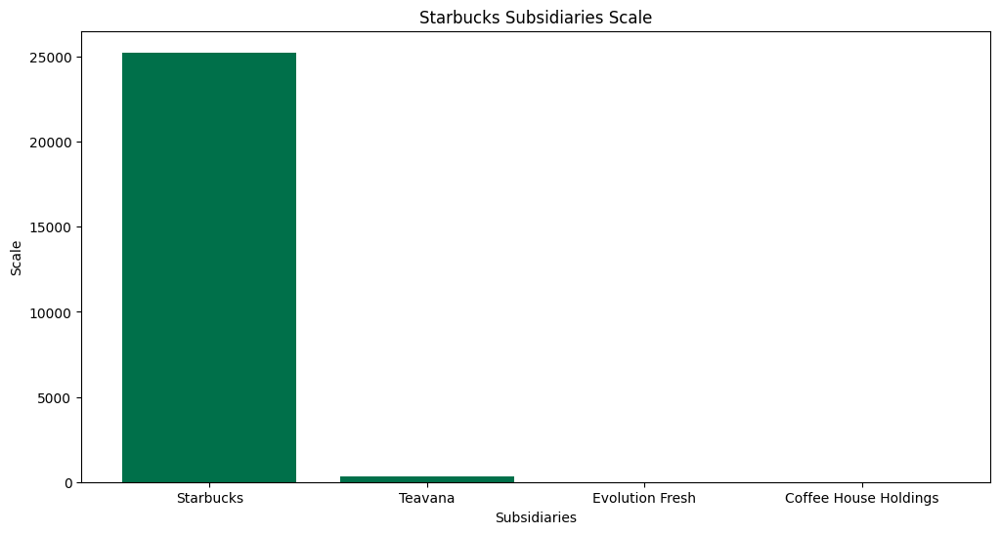

In [6]:
brand_count = df['Brand'].value_counts()
index = brand_count.index
value = brand_count.values

plt.figure(figsize = (12,6))
plt.bar(index, value, color = '#00704A')
plt.xlabel('Subsidiaries')
plt.ylabel('Scale')
plt.title('Starbucks Subsidiaries Scale')
plt.show()

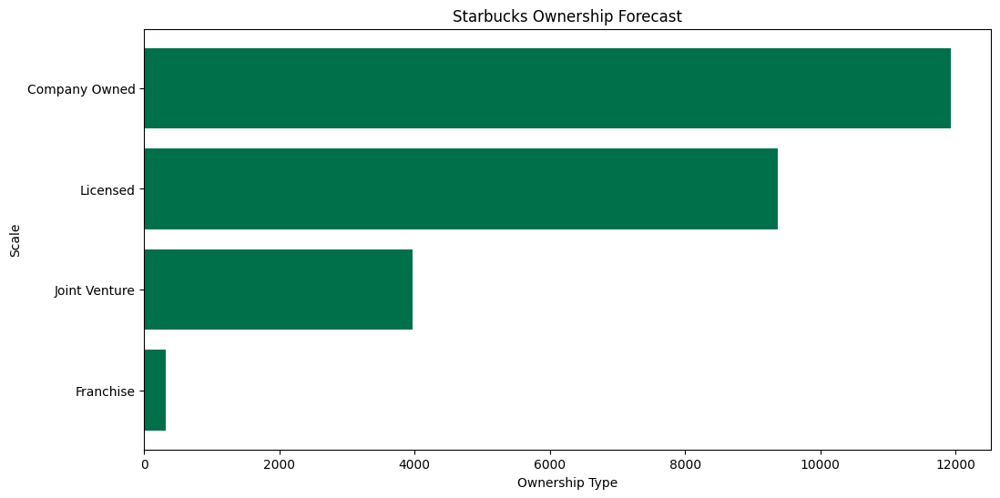

In [7]:
ownership = df['Ownership Type'].value_counts().sort_values(ascending=True)
ownr_index = ownership.index
ownr_values = ownership.values

plt.figure(figsize = (12, 6))
plt.barh(ownr_index, ownr_values, color = '#00704A')
plt.xlabel('Ownership Type')
plt.ylabel('Scale')
plt.title('Starbucks Ownership Forecast')
plt.show()

In [8]:
df.head()

,Brand,Store Number,Store Name,Ownership Type,Street Address,City,State/Province,Country,Postcode,Phone Number,Timezone,Longitude,Latitude
0,Starbucks,47370-257954,"Meritxell, 96",Licensed,"Av. Meritxell, 96",Andorra la Vella,7,AD,AD500,376818720,GMT+1:00 Europe/Andorra,1.53,42.51
1,Starbucks,22331-212325,Ajman Drive Thru,Licensed,"1 Street 69, Al Jarf",Ajman,AJ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,55.47,25.42
2,Starbucks,47089-256771,Dana Mall,Licensed,Sheikh Khalifa Bin Zayed St.,Ajman,AJ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,55.47,25.39
3,Starbucks,22126-218024,Twofour 54,Licensed,Al Salam Street,Abu Dhabi,AZ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,54.38,24.48
4,Starbucks,17127-178586,Al Ain Tower,Licensed,"Khaldiya Area, Abu Dhabi Island",Abu Dhabi,AZ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,54.54,24.51


In [9]:
country = df['Country'].value_counts().reset_index().head(5)
country.columns = ['Country', 'Count']
country.sort_values(by = 'Count', ascending= True)

fig = px.treemap(country,
                 path = ['Country'],
                 values = 'Count',
                 title = 'Top 5 Countries with Most Starbuck Stores')
fig.update_layout(width = 800, height = 600)
fig.show()

In [10]:
df_china = df[df['Country'] == 'CN']

# Displaying only the 'City' column in a DataFrame format
df_china_cities = df_china[['Country','City']]
df_china_cities

,Country,City
2091,CN,北京市
2092,CN,北京市
2093,CN,北京市
2094,CN,北京市
2095,CN,北京市
...,...,...
4820,CN,Macau
4821,CN,Macau
4822,CN,Macau
4823,CN,Macau


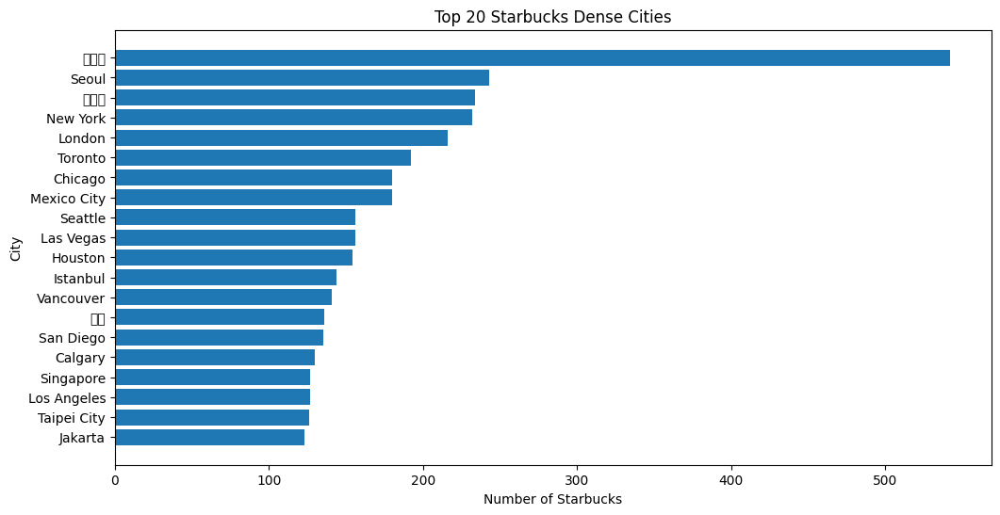

In [11]:
city = df['City'].value_counts().reset_index()
city.columns = ['City', 'Count']

top_cities = city.head(20)

top_cities = top_cities.sort_values(by='Count', ascending=True)

city_index = top_cities['City']
city_values = top_cities['Count']


plt.figure(figsize=(12, 6))
plt.barh(city_index, city_values)
plt.title('Top 20 Starbucks Dense Cities')
plt.xlabel('Number of Starbucks')
plt.ylabel('City')
plt.show()

In [15]:
na_longitude = df[df['Longitude'].isna()].index
df=df.drop(na_longitude)

In [16]:
geometry_points = gpd.points_from_xy(df.Longitude,df.Latitude)
df=gpd.GeoDataFrame(df,crs = 'EPSG:4326',geometry = geometry_points)

In [17]:
map = leaf.Map(width=1200,height = 1000)
df.explore(m=map)

map